Implementação realizada por **Vitória Maria Silva Bispo** durante as disciplinas Mografia I e II no trabalho intitulado: **"Geração de Imagens Citológicas Sintéticas Através de Redes Generativas Adversárias"**.

O seguinte **guia de implementação** foi utilizado: https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html

## Imports e entradas necessários

In [ ]:
#%matplotlib inline
import argparse
import os
import re
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

from datetime import datetime

from time import perf_counter # biblioteca para medir o tempo do treinamento

Conectando com drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Definindo base de dados

In [ ]:
# Base de dados CRIC (High grade lesion)
#dataroot = ['/content/drive/MyDrive/UFOP/23.2/Monografia/Databases/CRIC/CroppedCells/HGL']

# Base de dados CRIC (Low grade lesion)
#dataroot = ['/content/drive/MyDrive/UFOP/23.2/Monografia/Databases/CRIC/CroppedCells/LGL']

# Base de dados CRIC (No lesion)
dataroot = ['/content/drive/MyDrive/UFOP/23.2/Monografia/Databases/CRIC/CroppedCells/NL']

Definindo parâmetros

In [ ]:
# Epoch em que o treinamento foi interrompido
epoch_restore = 300

# Tamanho do vetor de ruído
nz = 256

# Número de threads p/ carregar o arquivo com o DataLoader
workers = 2

# Tamanho do batch definido no artigo
batch_size = 128

# Tamanho para redimensionar as imagens
image_size = 64

# Número de canais (três, visto que as imagens são coloridas)
nc = 3

# Quantidade de epochs de treinamento
num_epochs = 400

# Learning rate p/ otimizador
lr = 0.0002

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Verificar se há GPU disponível
if torch.cuda.is_available():
  ngpu = torch.cuda.device_count() # Obter o número de GPUs disponíveis
else:
  ngpu = 0

print("Quantidade de GPUs disponíveis:", ngpu)

# Checkpoints gerador e discriminador
checkpoint_path = "/content/drive/MyDrive/UFOP/23.2/Monografia/checkpoints/checkpoint_20240103_110455"

Quantidade de GPUs disponíveis: 1


## Criando o dataloader

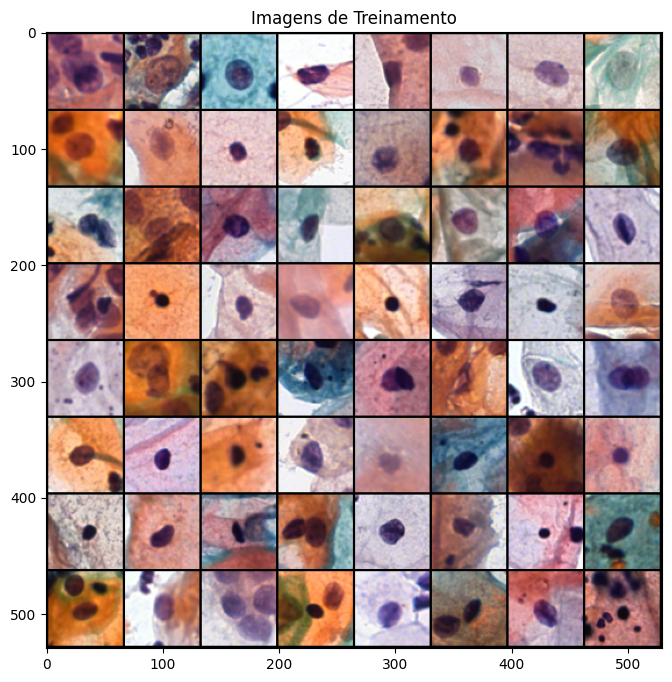

In [ ]:
# Combinando os datasets das tres pastas do CRIC
datasets = [dset.ImageFolder(root=path, transform=transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])) for path in dataroot]

# Concatenando os datasets
dataset = torch.utils.data.ConcatDataset(datasets)

# Criando o dataloader a partir do dataset concatenado
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Selecionando dispositivo (GPU se tiver, ou CPU)
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plotando algumas imagens do dataloader
real_batch = next(iter(dataloader))
plt.figure(figsize=(8, 8))
plt.title("Imagens de Treinamento")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(), (1, 2, 0)))

plt.show()

In [ ]:
print(len(dataloader))

49


## Pesos

In [ ]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

## Gerador

In [ ]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(256, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


## Discriminador

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


## Perda do discriminador (BCE)

In [ ]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

## Restaurando o checkpoint

In [ ]:
# Caminhos completos dos arquivos
file_path_discriminator = os.path.join(checkpoint_path, 'discriminator_checkpoint_{:03d}.pt'.format(epoch_restore))
file_path_generator = os.path.join(checkpoint_path, 'generator_checkpoint_{:03d}.pt'.format(epoch_restore))

In [ ]:
# Carregar os pesos do Gerador a partir do arquivo de checkpoint
checkpoint_generator = torch.load(file_path_generator, map_location=device)
netG.load_state_dict(checkpoint_generator['model_state_dict'])
optimizerG.load_state_dict(checkpoint_generator['optimizer_state_dict'])


In [ ]:
# Criar uma instância do discriminador
discriminator = Discriminator(ngpu)

# Carregar os pesos do discriminador a partir do arquivo de checkpoint
checkpoint_discriminator = torch.load(file_path_discriminator, map_location=device)
netD.load_state_dict(checkpoint_discriminator['model_state_dict'])
optimizerD.load_state_dict(checkpoint_discriminator['optimizer_state_dict'])


## Treinamento

In [ ]:
# Registra o tempo de início
start_time = perf_counter()

In [ ]:
# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

In [ ]:
print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        #if i % 50 == 0:
        print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch+1, num_epochs, i+1, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

A saída de streaming foi truncada nas últimas 5000 linhas.
[298/400][48/49]	Loss_D: 0.0134	Loss_G: 5.8824	D(x): 0.9918	D(G(z)): 0.0051 / 0.0058
[298/400][49/49]	Loss_D: 0.0225	Loss_G: 6.4864	D(x): 0.9933	D(G(z)): 0.0153 / 0.0026
[299/400][1/49]	Loss_D: 0.0253	Loss_G: 5.6337	D(x): 0.9833	D(G(z)): 0.0082 / 0.0078
[299/400][2/49]	Loss_D: 0.0186	Loss_G: 5.7290	D(x): 0.9930	D(G(z)): 0.0113 / 0.0066
[299/400][3/49]	Loss_D: 0.0175	Loss_G: 6.0191	D(x): 0.9919	D(G(z)): 0.0092 / 0.0049
[299/400][4/49]	Loss_D: 0.0143	Loss_G: 6.2042	D(x): 0.9943	D(G(z)): 0.0084 / 0.0039
[299/400][5/49]	Loss_D: 0.0151	Loss_G: 6.1699	D(x): 0.9907	D(G(z)): 0.0057 / 0.0044
[299/400][6/49]	Loss_D: 0.0155	Loss_G: 6.1026	D(x): 0.9927	D(G(z)): 0.0080 / 0.0051
[299/400][7/49]	Loss_D: 0.0249	Loss_G: 5.3477	D(x): 0.9821	D(G(z)): 0.0067 / 0.0112
[299/400][8/49]	Loss_D: 0.0210	Loss_G: 5.9664	D(x): 0.9966	D(G(z)): 0.0171 / 0.0052
[299/400][9/49]	Loss_D: 0.0180	Loss_G: 6.3140	D(x): 0.9918	D(G(z)): 0.0095 / 0.0040
[299/400][10/49

In [ ]:
# Registra o tempo de término
end_time = perf_counter()

## Resultados

In [ ]:
# Calcula o tempo de execução
execution_time = end_time - start_time

# Imprime o tempo de execução
print(f"Tempo de treinamento: {execution_time} segundos ({execution_time/60:.2f}min)")

Tempo de treinamento: 3274.207202413 segundos (54.57min)


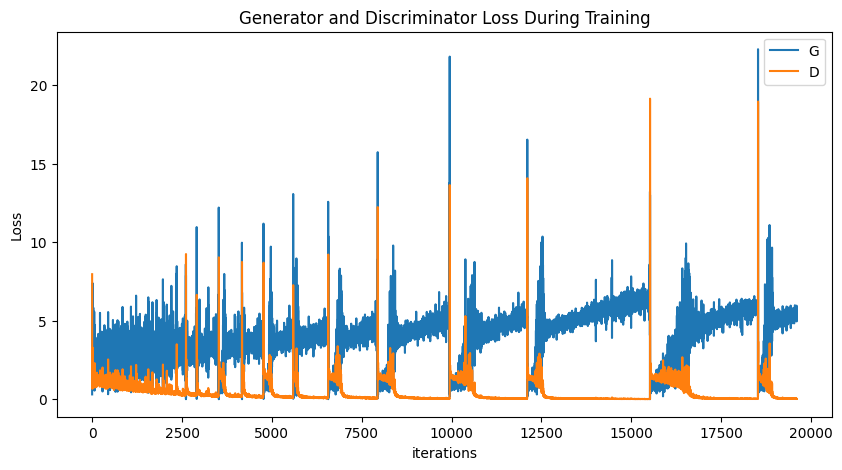

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

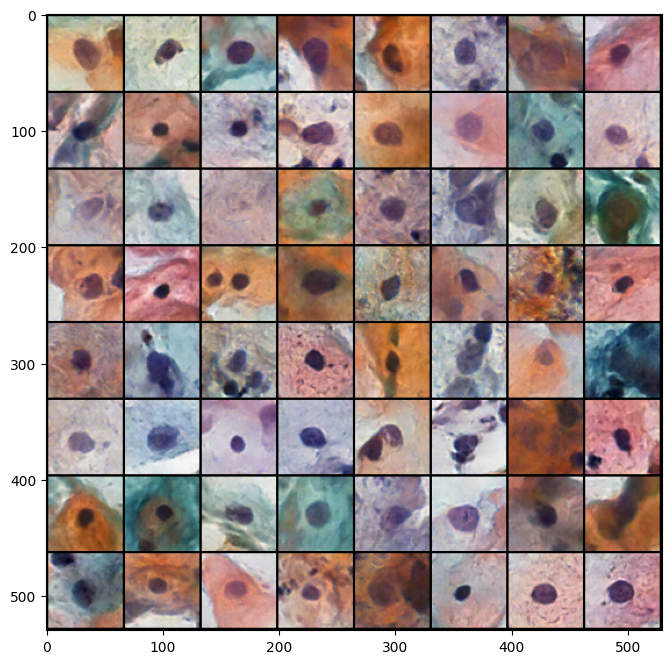

In [ ]:
fig = plt.figure(figsize=(8,8))

ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

## Amostras Geradas

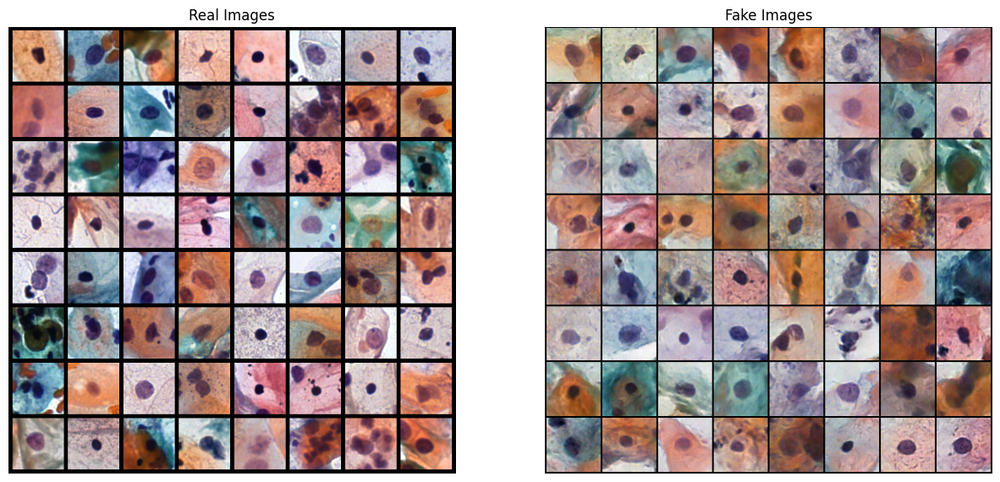

In [ ]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

## Salvando pesos do Gerador

In [ ]:
current_datetime = datetime.now().strftime("%Y%m%d_%H%M%S")
folder_name = "checkpoint_" + current_datetime
save_path = os.path.join("/content/drive/MyDrive/UFOP/23.2/Monografia/generator/generator_ckpt/", folder_name)
os.makedirs(save_path, exist_ok=True)

# Nome dos arquivos dentro da pasta
filename_generator = 'generator_checkpoint_{:03d}.pt'.format(num_epochs)

# Caminhos completos dos arquivos
file_path_generator = os.path.join(save_path, filename_generator)

In [ ]:
torch.save({
    'epoch': num_epochs,
    'model_state_dict': netG.state_dict(),
    'optimizer_state_dict': optimizerG.state_dict(),
    'loss': errG.item(),
    }, file_path_generator)